# Example Usage of UMAP Data Projection

This notebook illustrates how to generate and visualize UMAP projections.

Install the following libraries to make this notebook work (in addition to those specified in the repo `requirements.txt`):

```
pip install umap-learn umap-learn[plot] pyarrow dask==2024.12.1 dask[dataframe] bokeh
```

In [1]:
# `pip install umap-learn`
import umap

# `pip install umap-learn[plot]`
import umap.plot

import numpy as np
import pandas as pd

# `pip install bokeh`
import bokeh
import bokeh.plotting
import bokeh.io

bokeh.io.output_notebook()


import utils
import plot

/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/numba/np/ufunc/dufunc.py:344: NumbaWarning: Compilation requested for previously compiled argument types ((uint32,)). This has no effect and perhaps indicates a bug in the calling code (compiling a ufunc more than once for the same signature
  warnings.warn(msg, errors.NumbaWarning)
/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/numba/np/ufunc/dufunc.py:344: NumbaWarning: Compilation requested for previously compiled argument types ((uint32,)). This has no effect and perhaps indicates a bug in the calling code (compiling a ufunc more than once for the same signature
  warnings.warn(msg, errors.NumbaWarning)
/home/aaron/code/StepUP/venv/lib/python3.11/site-pack

Loading BokehJS ...

In [2]:
class UMAP_Projection:
  def __init__(self):
    self.reducer = umap.UMAP()

  def fit(self, data, metadata, color_by, **kwargs):
    # umaps expects data to be a 2D numpy array. Flatten any higher-dimensional data provided
    if len(data.shape) > 2:
      data = data.reshape(data.shape[0], -1)

    self.data = data
    self.metadata = metadata
    self.color_by = color_by
    
    self.model_params = kwargs


    self.umap_model = self.reducer.fit(self.data, **self.model_params)

    self.hover_data = metadata['ParticipantID Footwear Speed Side PassID FootstepID Rscore'.split()].reset_index(drop=True)
    self.bokeh_figure = umap.plot.interactive(self.umap_model, labels=metadata[color_by].to_numpy(), hover_data=self.hover_data, width=2000, height=2000, point_size=7)
  
  def refit(self, **kwargs):
    for k, v in kwargs.items():
      self.model_params[k] = v

    self.umap_model = self.reducer.fit(self.data, **self.model_params)
    self.bokeh_figure = umap.plot.interactive(self.umap_model, labels=self.metadata[self.color_by].to_numpy(), hover_data=self.hover_data, width=2000, height=2000, point_size=7)

  def show(self):
    umap.plot.show(self.bokeh_figure)
  

  def filter(self, pandas_query_string):
    matching_row_ids = set(self.metadata.reset_index(drop=True).query(pandas_query_string).index)

    alpha_values = [1 if r in matching_row_ids else 0.05 for r in range(self.data.shape[0])]
    self._set_alpha_values(alpha_values)

    print('Call `umap_projection.show()` to display newly filtered visualization.')

  def reset_filter(self):
    alpha_values = [1 for _ in range(self.data.shape[0])]
    self._set_alpha_values(alpha_values)
       
  def _set_alpha_values(self, alpha_values):
    self.bokeh_figure.renderers[0].data_source.data['alpha'] = alpha_values



# Load Metadata

In [3]:
metadatas = []

for p, f, s in utils.iter_trials():
  print(p, f, s)
  metadatas.append(utils.load_metadata(p, f, s))

metadata = pd.concat(metadatas).reset_index(drop=True)
metadata.shape

1 BF W1
1 BF W2
1 BF W3
1 BF W4
1 ST W1
1 ST W2
1 ST W3
1 ST W4
1 P1 W1
1 P1 W2
1 P1 W3
1 P1 W4
1 P2 W1
1 P2 W2
1 P2 W3
1 P2 W4
2 BF W1
2 BF W2
2 BF W3
2 BF W4
2 ST W1
2 ST W2
2 ST W3
2 ST W4
2 P1 W1
2 P1 W2
2 P1 W3
2 P1 W4
2 P2 W1
2 P2 W2
2 P2 W3
2 P2 W4
3 BF W1
3 BF W2
3 BF W3
3 BF W4
3 ST W1
3 ST W2
3 ST W3
3 ST W4
3 P1 W1
3 P1 W2
3 P1 W3
3 P1 W4
3 P2 W1
3 P2 W2
3 P2 W3
3 P2 W4
4 BF W1
4 BF W2
4 BF W3
4 BF W4
4 ST W1
4 ST W2
4 ST W3
4 ST W4
4 P1 W1
4 P1 W2
4 P1 W3
4 P1 W4
4 P2 W1
4 P2 W2
4 P2 W3
4 P2 W4
5 BF W1
5 BF W2
5 BF W3
5 BF W4
5 ST W1
5 ST W2
5 ST W3
5 ST W4
5 P1 W1
5 P1 W2
5 P1 W3
5 P1 W4
5 P2 W1
5 P2 W2
5 P2 W3
5 P2 W4
6 BF W1
6 BF W2
6 BF W3
6 BF W4
6 ST W1
6 ST W2
6 ST W3
6 ST W4
6 P1 W1
6 P1 W2
6 P1 W3
6 P1 W4
6 P2 W1
6 P2 W2
6 P2 W3
6 P2 W4
7 BF W1
7 BF W2
7 BF W3
7 BF W4
7 ST W1
7 ST W2
7 ST W3
7 ST W4
7 P1 W1
7 P1 W2
7 P1 W3
7 P1 W4
7 P2 W1
7 P2 W2
7 P2 W3
7 P2 W4
8 BF W1
8 BF W2
8 BF W3
8 BF W4
8 ST W1
8 ST W2
8 ST W3
8 ST W4
8 P1 W1
8 P1 W2
8 P1 W3
8 P1 W4
8 P2 W1


(215864, 25)

In [4]:
metadata.head()

,ParticipantID,Footwear,Speed,FootstepID,PassID,StartFrame,EndFrame,Ymin,Ymax,Xmin,...,Rscore,Outlier,Exclude,RotationAngle,FootLength,FootWidth,MeanGRF,height,width,Unnamed: 0
0,1,BF,W1,0,0,212,288,76,131,167,...,0.248545,0,0,4.246666,53.0,19.0,23270.396040,NaN,NaN,NaN
1,1,BF,W1,1,0,276,348,233,291,191,...,1.126682,0,0,1.618202,55.0,20.0,25024.029703,NaN,NaN,NaN
2,1,BF,W1,2,0,331,407,385,439,167,...,0.511779,0,0,4.133031,53.0,19.0,19953.871287,NaN,NaN,NaN
3,1,BF,W1,3,0,393,469,537,593,189,...,0.188634,0,0,3.611146,55.0,18.0,20826.940594,NaN,NaN,NaN
4,1,BF,W1,4,0,454,498,689,710,183,...,7.175712,1,1,22.316611,21.0,13.0,70282.683168,NaN,NaN,NaN


# Load and Project GRFs

In [5]:
grfs = []

for p, f, s in utils.iter_trials():
  print(p, f, s)

  # EVE: todo - replace this `utils.load_cached_X()` with the appropriate call for loading your cached features
  grfs.append(utils.load_cached_grfs(p, f, s))

grfs = np.concatenate(grfs)
grfs.shape

1 BF W1
1 BF W2
1 BF W3
1 BF W4
1 ST W1
1 ST W2
1 ST W3
1 ST W4
1 P1 W1
1 P1 W2
1 P1 W3
1 P1 W4
1 P2 W1
1 P2 W2
1 P2 W3
1 P2 W4
2 BF W1
2 BF W2
2 BF W3
2 BF W4
2 ST W1
2 ST W2
2 ST W3
2 ST W4
2 P1 W1
2 P1 W2
2 P1 W3
2 P1 W4
2 P2 W1
2 P2 W2
2 P2 W3
2 P2 W4
3 BF W1
3 BF W2
3 BF W3
3 BF W4
3 ST W1
3 ST W2
3 ST W3
3 ST W4
3 P1 W1
3 P1 W2
3 P1 W3
3 P1 W4
3 P2 W1
3 P2 W2
3 P2 W3
3 P2 W4
4 BF W1
4 BF W2
4 BF W3
4 BF W4
4 ST W1
4 ST W2
4 ST W3
4 ST W4
4 P1 W1
4 P1 W2
4 P1 W3
4 P1 W4
4 P2 W1
4 P2 W2
4 P2 W3
4 P2 W4
5 BF W1
5 BF W2
5 BF W3
5 BF W4
5 ST W1
5 ST W2
5 ST W3
5 ST W4
5 P1 W1
5 P1 W2
5 P1 W3
5 P1 W4
5 P2 W1
5 P2 W2
5 P2 W3
5 P2 W4
6 BF W1
6 BF W2
6 BF W3
6 BF W4
6 ST W1
6 ST W2
6 ST W3
6 ST W4
6 P1 W1
6 P1 W2
6 P1 W3
6 P1 W4
6 P2 W1
6 P2 W2
6 P2 W3
6 P2 W4
7 BF W1
7 BF W2
7 BF W3
7 BF W4
7 ST W1
7 ST W2
7 ST W3
7 ST W4
7 P1 W1
7 P1 W2
7 P1 W3
7 P1 W4
7 P2 W1
7 P2 W2
7 P2 W3
7 P2 W4
8 BF W1
8 BF W2
8 BF W3
8 BF W4
8 ST W1
8 ST W2
8 ST W3
8 ST W4
8 P1 W1
8 P1 W2
8 P1 W3
8 P1 W4
8 P2 W1


(215864, 101)

In [ ]:
filtered_metadata = metadata.query('Exclude == 0 & Speed != "W2"')
filtered_metadata.shape

(4845, 25)

In [7]:
filtered_grfs = grfs[filtered_metadata.index]
filtered_grfs.shape

(4845, 101)

In [8]:
grf_umap = UMAP_Projection()
grf_umap.fit(filtered_grfs, filtered_metadata, color_by='Speed')

grf_umap.show()

/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [9]:
# Filters can be applied to draw visual salience to samples of interest
p_id = 1

grf_umap.filter('ParticipantID == @p_id and Rscore > 0.2')
grf_umap.show()

Call `umap_projection.show()` to display newly filtered visualization.


In [12]:
# UMAP model parameters can be specified as kwargs (to both `.fit()` and `.refit()`)
# Specified params are saved and reused in future calls.

grf_umap.refit(n_neighbours=2)
grf_umap.show()

/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


# Load and Project P100s

In [13]:
p100s = []

for p, f, s in utils.iter_trials():
  print(p, f, s)
  p100s.append(utils.load_cached_p100s(p, f, s))

p100s = np.concat(p100s)
p100s.shape

1 BF W1
1 BF W2
1 BF W3
1 BF W4
1 ST W1
1 ST W2
1 ST W3
1 ST W4
1 P1 W1
1 P1 W2
1 P1 W3
1 P1 W4
1 P2 W1
1 P2 W2
1 P2 W3
1 P2 W4
2 BF W1
2 BF W2
2 BF W3
2 BF W4
2 ST W1
2 ST W2
2 ST W3
2 ST W4
2 P1 W1
2 P1 W2
2 P1 W3
2 P1 W4
2 P2 W1
2 P2 W2
2 P2 W3
2 P2 W4
3 BF W1
3 BF W2
3 BF W3
3 BF W4
3 ST W1
3 ST W2
3 ST W3
3 ST W4
3 P1 W1
3 P1 W2
3 P1 W3
3 P1 W4
3 P2 W1
3 P2 W2
3 P2 W3
3 P2 W4
4 BF W1
4 BF W2
4 BF W3
4 BF W4
4 ST W1
4 ST W2
4 ST W3
4 ST W4
4 P1 W1
4 P1 W2
4 P1 W3
4 P1 W4
4 P2 W1
4 P2 W2
4 P2 W3
4 P2 W4
5 BF W1
5 BF W2
5 BF W3
5 BF W4
5 ST W1
5 ST W2
5 ST W3
5 ST W4
5 P1 W1
5 P1 W2
5 P1 W3
5 P1 W4
5 P2 W1
5 P2 W2
5 P2 W3
5 P2 W4
6 BF W1
6 BF W2
6 BF W3
6 BF W4
6 ST W1
6 ST W2
6 ST W3
6 ST W4
6 P1 W1
6 P1 W2
6 P1 W3
6 P1 W4
6 P2 W1
6 P2 W2
6 P2 W3
6 P2 W4
7 BF W1
7 BF W2
7 BF W3
7 BF W4
7 ST W1
7 ST W2
7 ST W3
7 ST W4
7 P1 W1
7 P1 W2
7 P1 W3
7 P1 W4
7 P2 W1
7 P2 W2
7 P2 W3
7 P2 W4
8 BF W1
8 BF W2
8 BF W3
8 BF W4
8 ST W1
8 ST W2
8 ST W3
8 ST W4
8 P1 W1
8 P1 W2
8 P1 W3
8 P1 W4
8 P2 W1


(215864, 75, 40)

In [14]:
filtered_metadata = metadata.query('Exclude == 0 & Speed != "W2"')
filtered_metadata.shape

(147998, 25)

In [15]:
filtered_p100s = p100s[filtered_metadata.index]
filtered_p100s.shape

(147998, 75, 40)

In [16]:
p100_umap = UMAP_Projection()
p100_umap.fit(filtered_p100s, filtered_metadata, color_by='Footwear')
p100_umap.show()

/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


## Does left-right separation go away by mirroring lefts footsteps?

<!-- ## Do the distinct left / right clusters go away if we mirror all lefts -->

In [14]:
left_footsteps = filtered_metadata.query('Side == "Left"')
left_footsteps.shape

(73856, 25)

In [15]:
idx = left_footsteps.index
p100s[idx] = np.flip(p100s[idx], axis=-1)

In [16]:
filtered_p100s = p100s[filtered_metadata.index]
filtered_p100s.shape

(147998, 75, 40)

In [17]:
reflected_p100_umap = UMAP_Projection()
reflected_p100_umap.fit(filtered_p100s, filtered_metadata, color_by='Footwear')
reflected_p100_umap.show()

/home/aaron/code/StepUP/venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [18]:
reflected_p100_umap.filter('Side == Left')
reflected_p100_umap.show()

## Participant 83 Details

Participant 83's barefoot data samples form an island separate from the larger barefoot cluster - I wonder why? Let's plot participant 83 data to investigate...

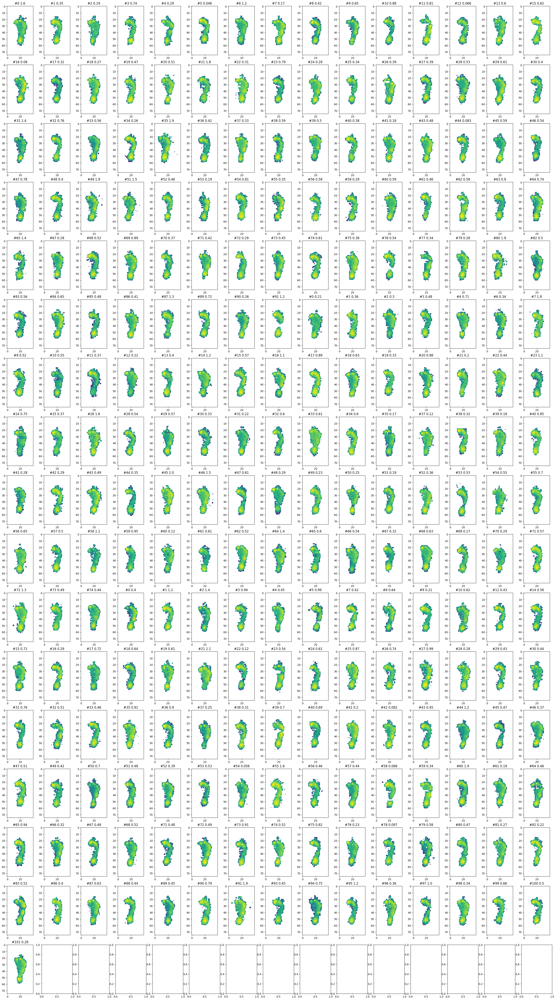

In [19]:
p83_metadata = filtered_metadata.query('ParticipantID == 83 and Footwear == "BF"')
p83_p100s = p100s[p83_metadata.index]

fig, axes = plot.plot_p100s(p83_p100s, metadata=p83_metadata, title_str='#{FootstepID} {Rscore:.2}')
fig.show()